In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
################################
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default = "plotly_white"
########################################
from sklearn.preprocessing import OneHotEncoder,QuantileTransformer,RobustScaler,StandardScaler,LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer,TransformedTargetRegressor
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
###################################################################################
from scipy.stats import norm
##################################
import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv('C:\\Users\\Dear User\\Downloads\\deliverytime (1).txt')

# data overview

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45593 entries, 0 to 45592
Data columns (total 11 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   ID                           45593 non-null  object 
 1   Delivery_person_ID           45593 non-null  object 
 2   Delivery_person_Age          45593 non-null  int64  
 3   Delivery_person_Ratings      45593 non-null  float64
 4   Restaurant_latitude          45593 non-null  float64
 5   Restaurant_longitude         45593 non-null  float64
 6   Delivery_location_latitude   45593 non-null  float64
 7   Delivery_location_longitude  45593 non-null  float64
 8   Type_of_order                45593 non-null  object 
 9   Type_of_vehicle              45593 non-null  object 
 10  Time_taken(min)              45593 non-null  int64  
dtypes: float64(5), int64(2), object(4)
memory usage: 3.8+ MB


In [4]:
df.head()

,ID,Delivery_person_ID,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Type_of_order,Type_of_vehicle,Time_taken(min)
0,4607,INDORES13DEL02,37,4.9,22.745049,75.892471,22.765049,75.912471,Snack,motorcycle,24
1,B379,BANGRES18DEL02,34,4.5,12.913041,77.683237,13.043041,77.813237,Snack,scooter,33
2,5D6D,BANGRES19DEL01,23,4.4,12.914264,77.678400,12.924264,77.688400,Drinks,motorcycle,26
3,7A6A,COIMBRES13DEL02,38,4.7,11.003669,76.976494,11.053669,77.026494,Buffet,motorcycle,21
4,70A2,CHENRES12DEL01,32,4.6,12.972793,80.249982,13.012793,80.289982,Snack,scooter,30


# Explory Data Analysis

In [5]:
#splitting features into categorical and numerical
categorical_feature=['ID','Delivery_person_ID','Type_of_order','Type_of_vehicle']
numerical_feature=['Delivery_person_Age','Delivery_person_Ratings','Restaurant_latitude','Restaurant_longitude','Delivery_location_latitude','Delivery_location_longitude','Time_taken(min)']

In [6]:
# percentage of missing values in each category
dict_={}
for feature in df.columns:
    dict_[feature]=((df[feature].isnull().sum())/len(df))*100
pd.DataFrame(dict_,index=['%age of missing value']).transpose()

,%age of missing value
ID,0.0
Delivery_person_ID,0.0
Delivery_person_Age,0.0
Delivery_person_Ratings,0.0
Restaurant_latitude,0.0
Restaurant_longitude,0.0
Delivery_location_latitude,0.0
Delivery_location_longitude,0.0
Type_of_order,0.0
Type_of_vehicle,0.0


In [7]:
#unique values in each column
dict_={}
for feature in df.columns:
    dict_[feature]=((df[feature].value_counts().shape[0]))
pd.DataFrame(dict_,index=['unique_counts']).transpose()

,unique_counts
ID,45451
Delivery_person_ID,1320
Delivery_person_Age,22
Delivery_person_Ratings,28
Restaurant_latitude,657
Restaurant_longitude,518
Delivery_location_latitude,4373
Delivery_location_longitude,4373
Type_of_order,4
Type_of_vehicle,4


In [8]:
df.shape

(45593, 11)

In [9]:
df.describe()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Time_taken(min)
count,45593.000000,45593.000000,45593.000000,45593.000000,45593.000000,45593.000000,45593.000000
mean,29.544075,4.632367,17.017729,70.231332,17.465186,70.845702,26.294607
std,5.696793,0.327708,8.185109,22.883647,7.335122,21.118812,9.383806
min,15.000000,1.000000,-30.905562,-88.366217,0.010000,0.010000,10.000000
25%,25.000000,4.600000,12.933284,73.170000,12.988453,73.280000,19.000000
50%,29.000000,4.700000,18.546947,75.898497,18.633934,76.002574,26.000000
75%,34.000000,4.800000,22.728163,78.044095,22.785049,78.107044,32.000000
max,50.000000,6.000000,30.914057,88.433452,31.054057,88.563452,54.000000


In [10]:
#we can see that in min_item_price column the min is -30, since it describes the price it can't be negative, we need to remove these values
df.drop(df[df['Restaurant_latitude']<0].index,axis=0,inplace=True)

In [11]:
#similarly total_outstanding_order describe the number of pending orders and again it can't be negative
df.drop(df[df['Restaurant_longitude']<0].index,axis=0,inplace=True)

In [12]:
#sns.pairplot(df , hue='Time_taken(min)' , markers='*')

In [13]:
# total number of delivery from each market
#df.groupby('ID')['Delivery_person_ID'].count().plot.bar()

<Axes: xlabel='Type_of_order', ylabel='count'>

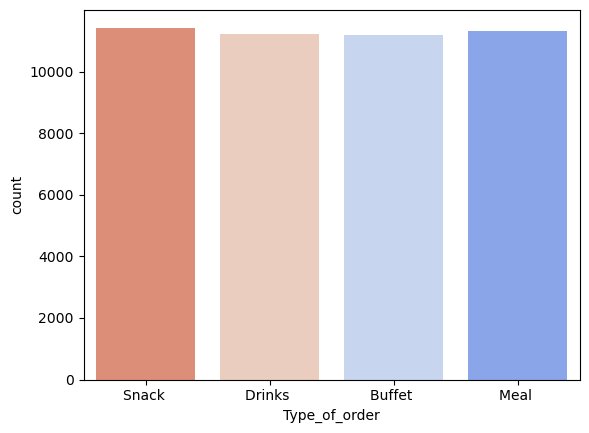

In [14]:
#ways in which different orders are placed(i.e., order protocol with most number of orders)
sns.countplot(x='Type_of_order',data=df,palette='coolwarm_r')

In [15]:
#top 20 i.e., most ordered category
#fig=plt.figure(figsize=(20,8))
#df['Type_of_order'].value_counts().sort_values(ascending=False)[:20].plot.bar()

In [16]:
# Correlation overview:

corr=df.corr()
corr

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Time_taken(min)
Delivery_person_Age,1.000000,-0.082477,0.001784,-0.000956,0.001776,-0.000958,0.295763
Delivery_person_Ratings,-0.082477,1.000000,-0.010110,-0.013132,-0.010617,-0.013308,-0.337176
Restaurant_latitude,0.001784,-0.010110,1.000000,0.692187,0.999988,0.692240,0.013377
Restaurant_longitude,-0.000956,-0.013132,0.692187,1.000000,0.692081,0.999999,0.007253
Delivery_location_latitude,0.001776,-0.010617,0.999988,0.692081,1.000000,0.692143,0.014983
Delivery_location_longitude,-0.000958,-0.013308,0.692240,0.999999,0.692143,1.000000,0.007810
Time_taken(min),0.295763,-0.337176,0.013377,0.007253,0.014983,0.007810,1.000000


<Axes: >

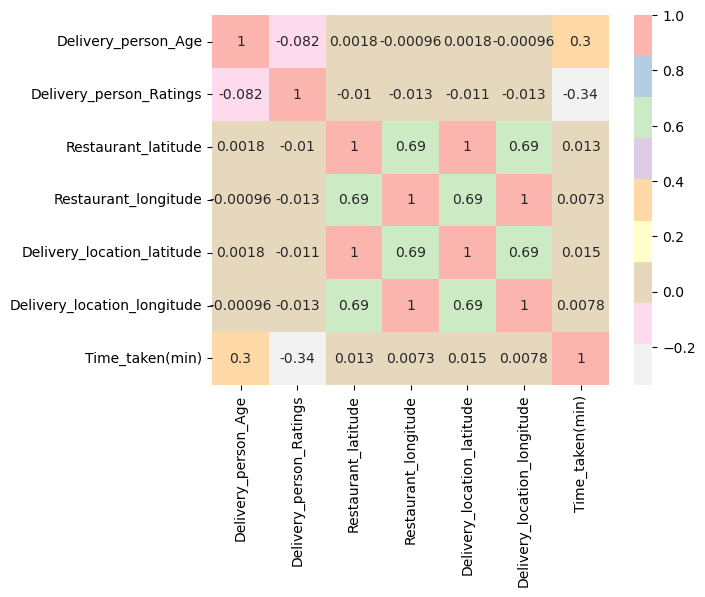

In [17]:
sns.heatmap(corr, cmap='Pastel1_r', annot=True)

<Axes: xlabel='Delivery_location_longitude'>

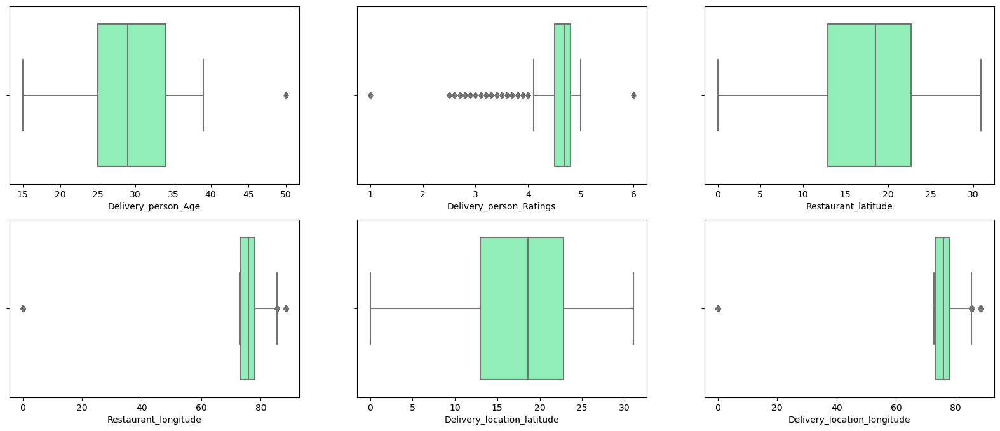

In [18]:
#Analysis of the numerical features 
fig=plt.figure(figsize=(20,8))
ax=[None for _ in range(6)]
ax[0]=plt.subplot2grid((2,3),(0,0))
ax[1]=plt.subplot2grid((2,3),(0,1))
ax[2]=plt.subplot2grid((2,3),(0,2))
ax[3]=plt.subplot2grid((2,3),(1,0))
ax[4]=plt.subplot2grid((2,3),(1,1))
ax[5]=plt.subplot2grid((2,3),(1,2))

sns.boxplot(x='Delivery_person_Age',data=df,palette='rainbow',ax=ax[0])
sns.boxplot(x='Delivery_person_Ratings',data=df,palette='rainbow',ax=ax[1])
sns.boxplot(x='Restaurant_latitude',data=df,palette='rainbow',ax=ax[2])
sns.boxplot(x='Restaurant_longitude',data=df,palette='rainbow',ax=ax[3])
sns.boxplot(x='Delivery_location_latitude',data=df,palette='rainbow',ax=ax[4])
sns.boxplot(x='Delivery_location_longitude',data=df,palette='rainbow',ax=ax[5])


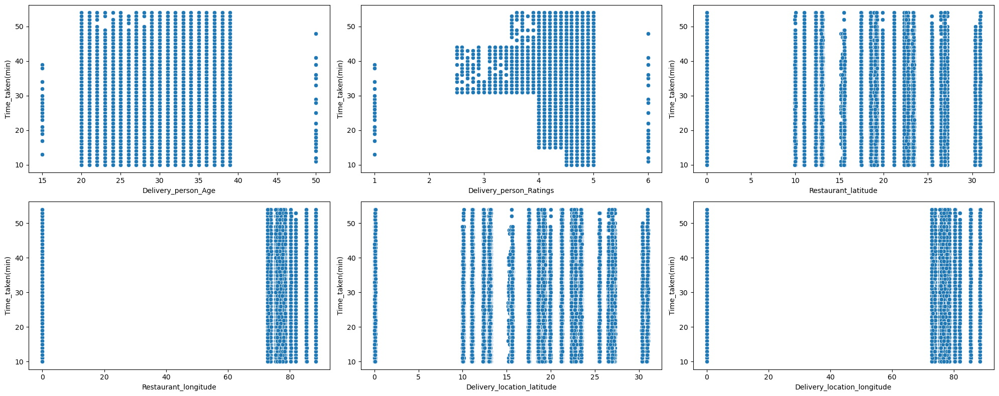

In [19]:
#bivariate analysis: to see how the other features are correlated with delivery time 'time_taken(mins)'
fig=plt.figure(figsize=(20,8))
ax=[None for _ in range(6)]
ax[0]=plt.subplot2grid((2,3),(0,0))
ax[1]=plt.subplot2grid((2,3),(0,1))
ax[2]=plt.subplot2grid((2,3),(0,2))
ax[3]=plt.subplot2grid((2,3),(1,0))
ax[4]=plt.subplot2grid((2,3),(1,1))
ax[5]=plt.subplot2grid((2,3),(1,2))

sns.scatterplot(x='Delivery_person_Age',y='Time_taken(min)',data=df,ax=ax[0])
sns.scatterplot(x='Delivery_person_Ratings',y='Time_taken(min)',data=df,ax=ax[1])
sns.scatterplot(x='Restaurant_latitude',y='Time_taken(min)',data=df,ax=ax[2])
sns.scatterplot(x='Restaurant_longitude',y='Time_taken(min)',data=df,ax=ax[3])
sns.scatterplot(x='Delivery_location_latitude',y='Time_taken(min)',data=df,ax=ax[4])
sns.scatterplot(x='Delivery_location_longitude',y='Time_taken(min)',data=df,ax=ax[5])
plt.tight_layout()

In [20]:
#separating categorical and numerical_variables
df_num=df[numerical_feature]
df_cat=df[categorical_feature]

In [21]:
#applying log_transformation on df_num
time_taken=df_num['Time_taken(min)']
df_num.drop('Time_taken(min)',axis=1,inplace=True)
for feature in df_num.columns:
    df_num[feature]=np.log(df_num[feature]+1)

In [22]:
#encoding categorical features
df_cat.head(3)

,ID,Delivery_person_ID,Type_of_order,Type_of_vehicle
0,4607,INDORES13DEL02,Snack,motorcycle
1,B379,BANGRES18DEL02,Snack,scooter
2,5D6D,BANGRES19DEL01,Drinks,motorcycle


<Axes: xlabel='Time_taken(min)', ylabel='count'>

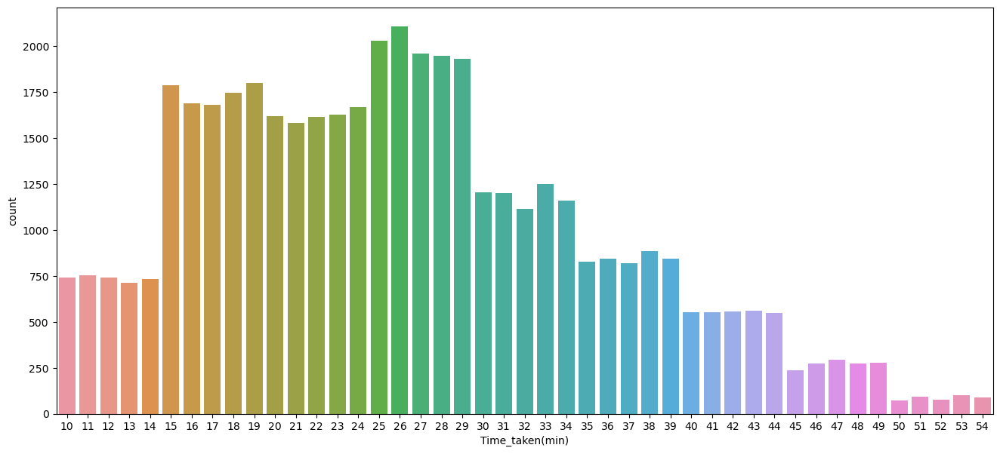

In [23]:
plt.subplots(figsize=(16,7))
sns.countplot(data=df , x='Time_taken(min)')

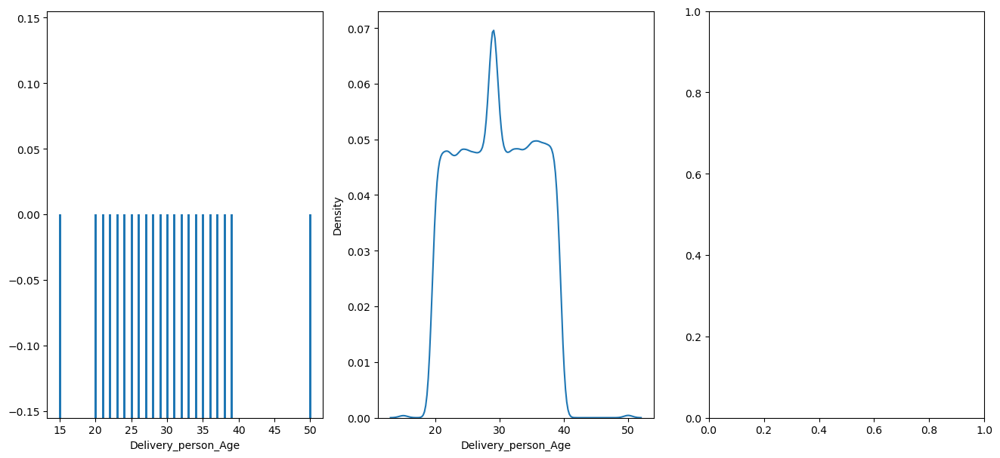

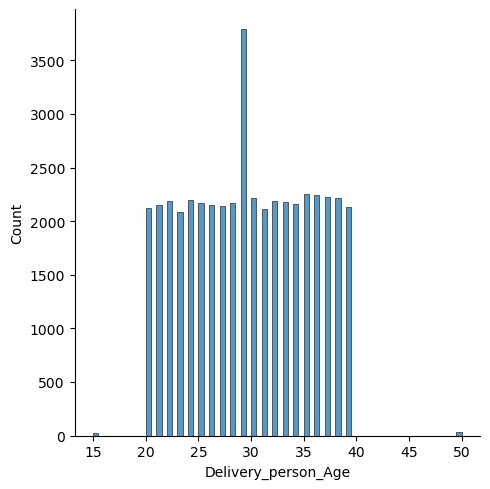

In [24]:
fig , axes = plt.subplots(1,3,figsize=(16,7))
sns.rugplot(ax = axes[0], data=df, x="Delivery_person_Age", height=0.5)
sns.kdeplot(ax = axes[1], data=df, x="Delivery_person_Age")
sns.displot(ax = axes[2], data=df, x="Delivery_person_Age")

<Axes: xlabel='Time_taken(min)', ylabel='Delivery_person_Age'>

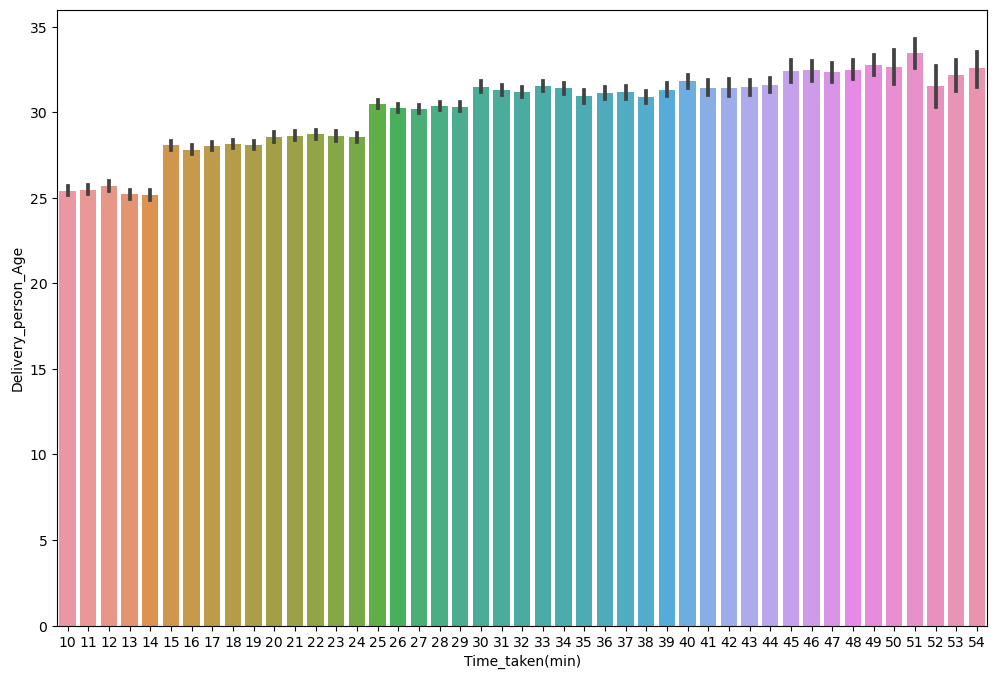

In [25]:
plt.figure(figsize=(12,8))
sns.barplot(data=df, x="Time_taken(min)" , y='Delivery_person_Age')

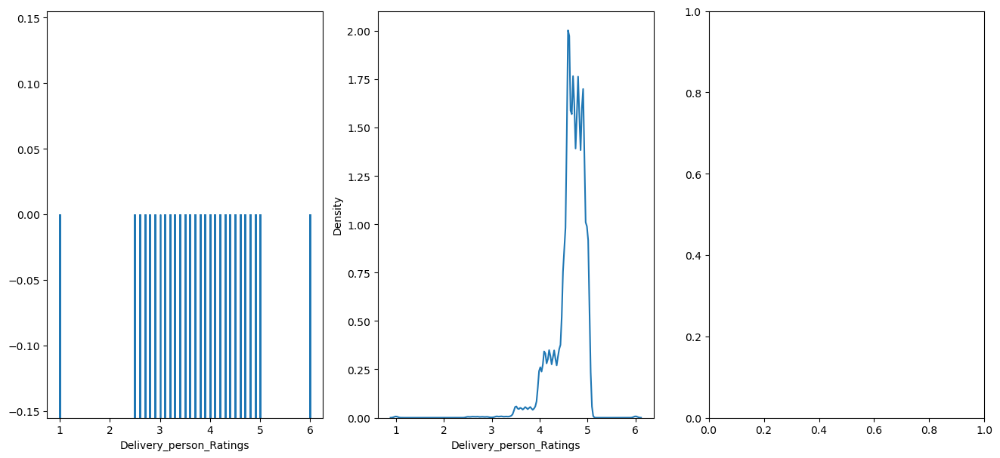

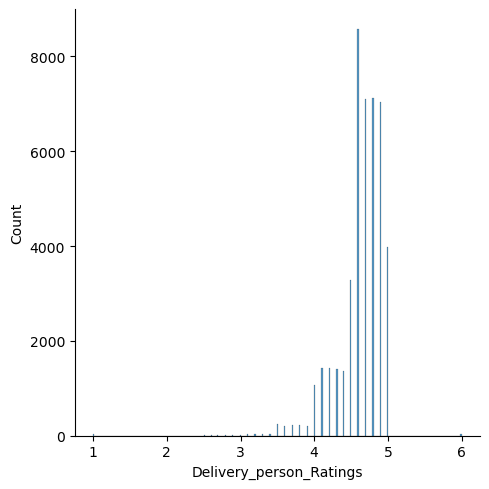

In [26]:
fig , axes = plt.subplots(1,3,figsize=(16,7))
sns.rugplot(ax = axes[0], data=df, x="Delivery_person_Ratings", height=0.5)
sns.kdeplot(ax = axes[1], data=df, x="Delivery_person_Ratings")
sns.displot(ax = axes[2], data=df, x="Delivery_person_Ratings")

<Axes: xlabel='Time_taken(min)', ylabel='Delivery_person_Ratings'>

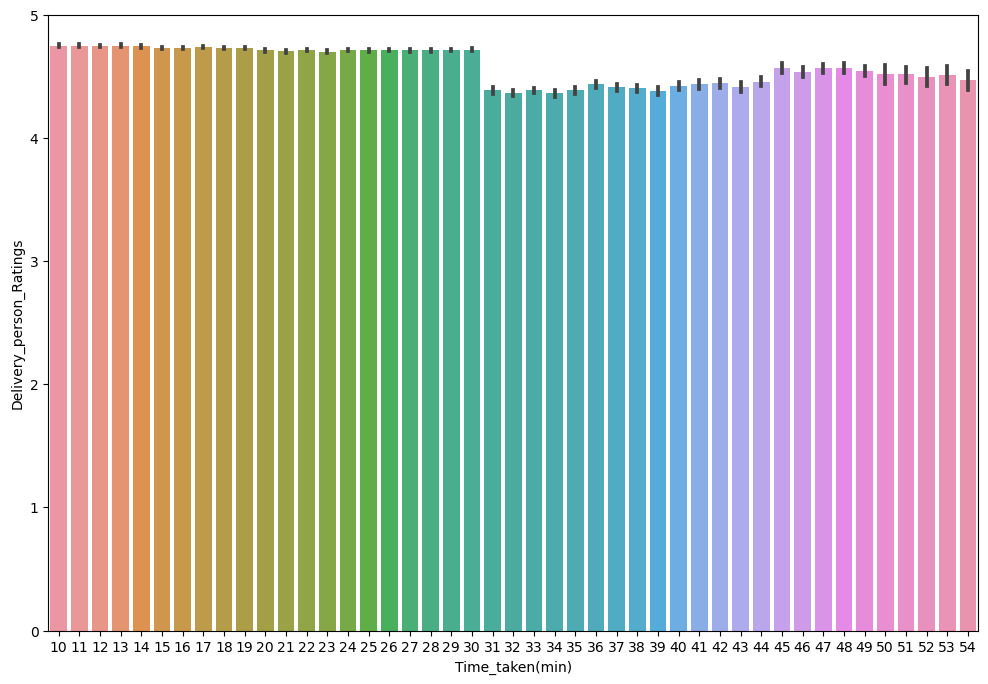

In [27]:
plt.figure(figsize=(12,8))
sns.barplot(data=df, x="Time_taken(min)" , y='Delivery_person_Ratings')

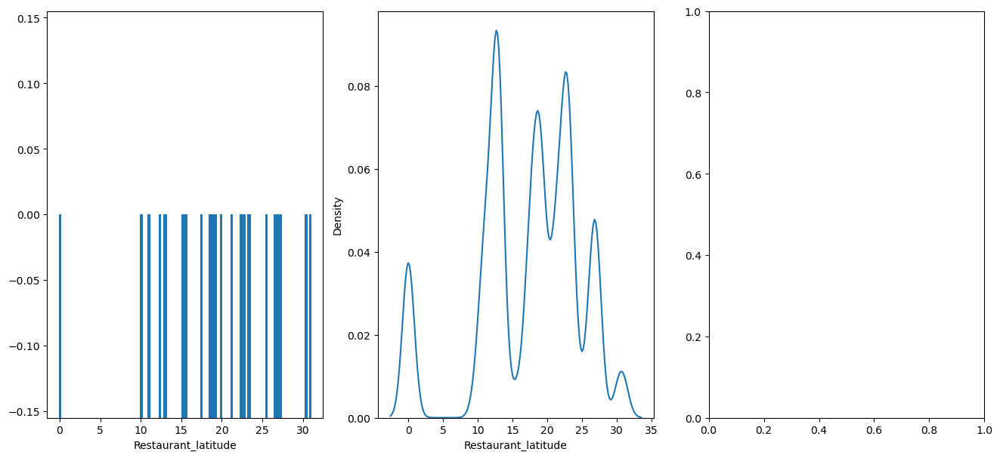

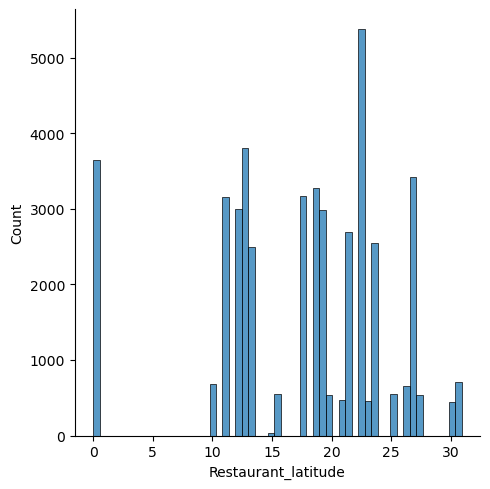

In [28]:
fig , axes = plt.subplots(1,3,figsize=(16,7))
sns.rugplot(ax = axes[0], data=df, x="Restaurant_latitude", height=0.5)
sns.kdeplot(ax = axes[1], data=df, x="Restaurant_latitude")
sns.displot(ax = axes[2], data=df, x="Restaurant_latitude")

<Axes: xlabel='Time_taken(min)', ylabel='Restaurant_latitude'>

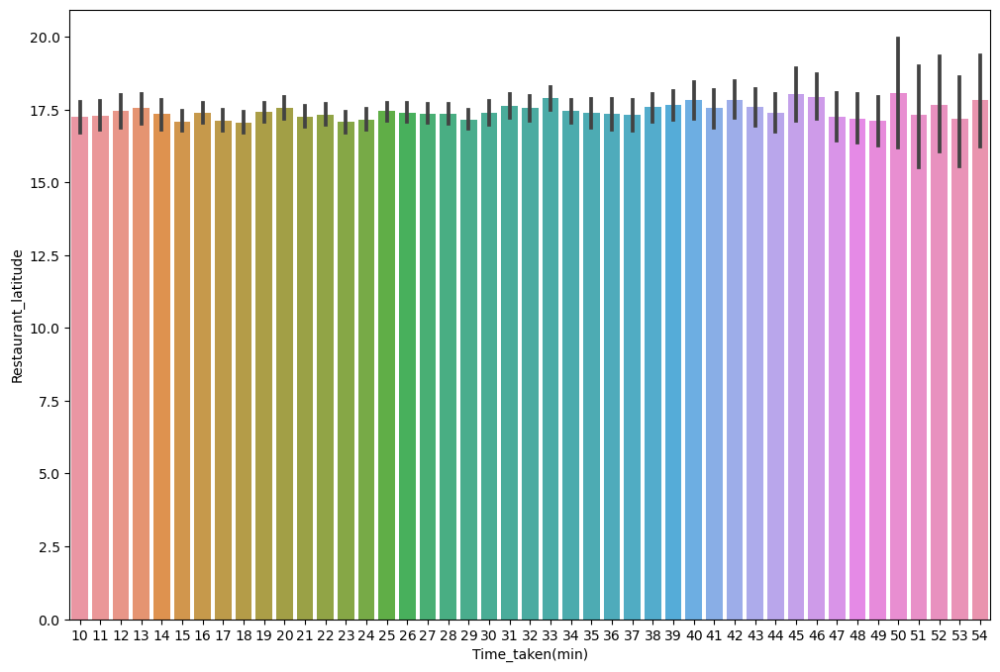

In [29]:
plt.figure(figsize=(12,8))
sns.barplot(data=df, x="Time_taken(min)" , y='Restaurant_latitude')

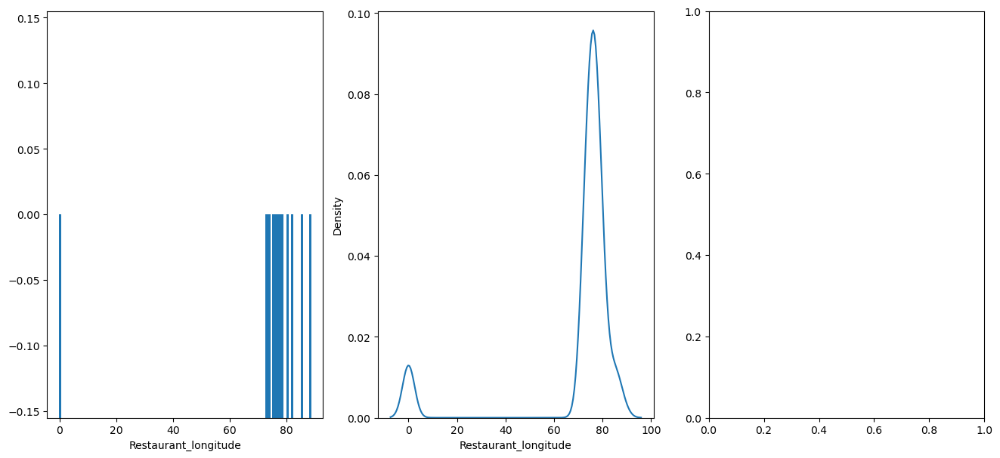

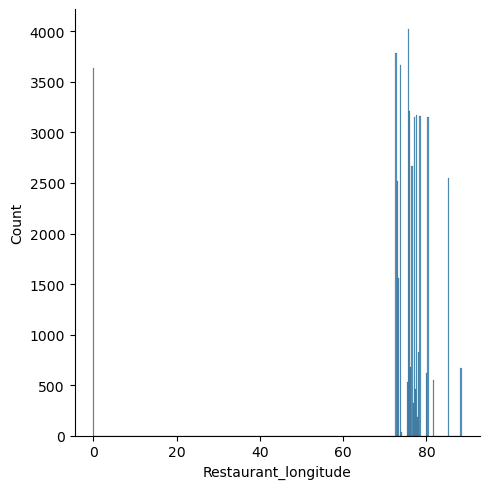

In [30]:
fig , axes = plt.subplots(1,3,figsize=(16,7))
sns.rugplot(ax = axes[0], data=df, x="Restaurant_longitude", height=0.5)
sns.kdeplot(ax = axes[1], data=df, x="Restaurant_longitude")
sns.displot(ax = axes[2], data=df, x="Restaurant_longitude")

<Axes: xlabel='Time_taken(min)', ylabel='Restaurant_longitude'>

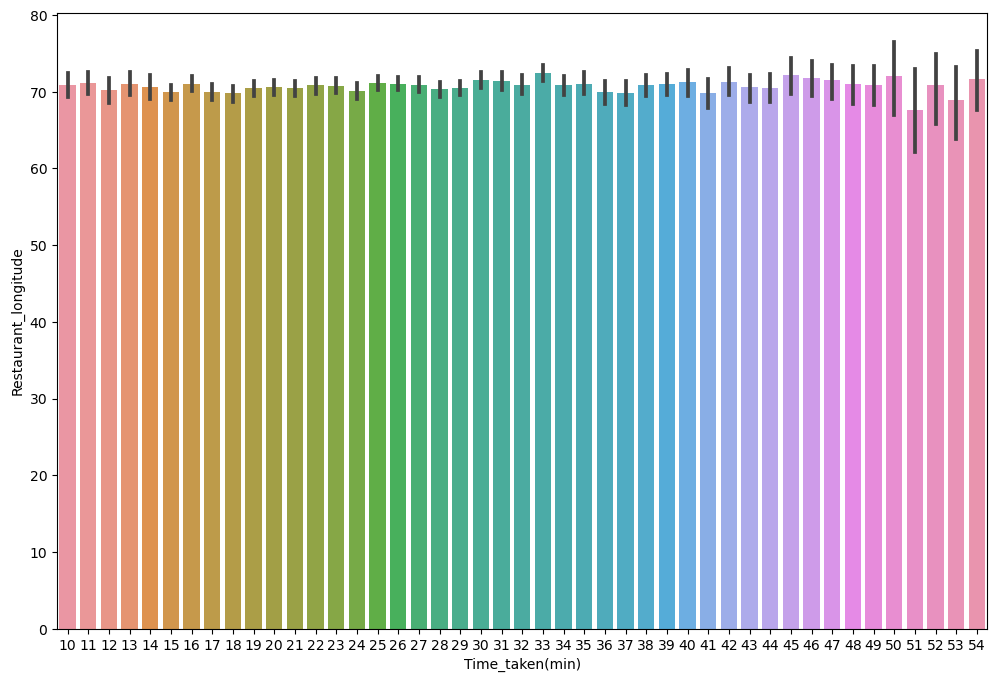

In [31]:
plt.figure(figsize=(12,8))
sns.barplot(data=df, x="Time_taken(min)" , y='Restaurant_longitude')

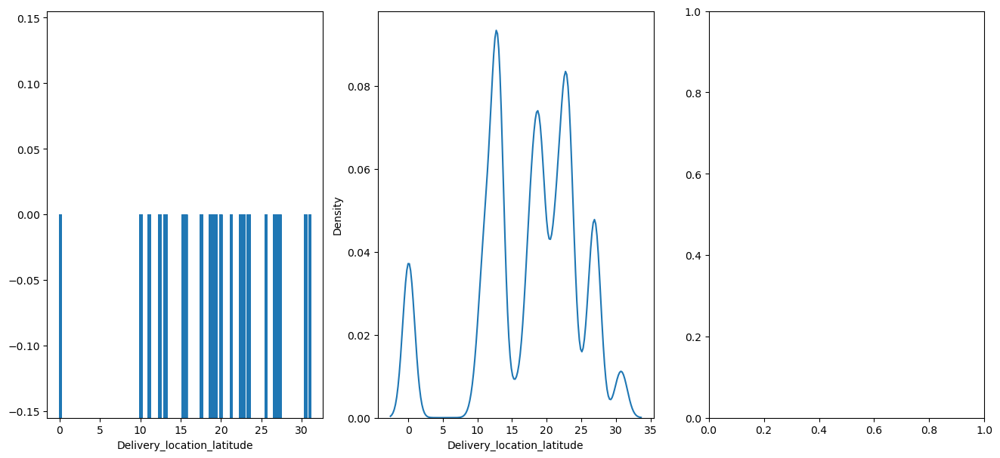

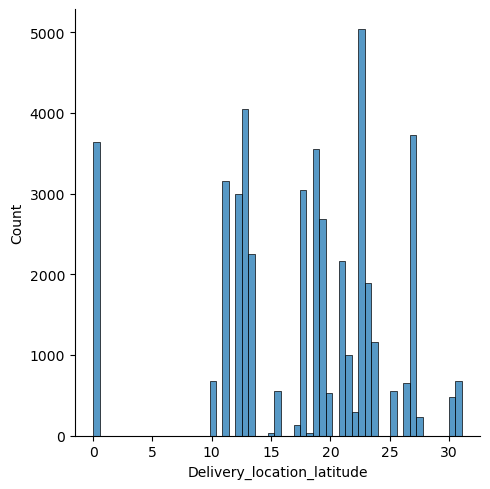

In [32]:
fig , axes = plt.subplots(1,3,figsize=(16,7))
sns.rugplot(ax = axes[0], data=df, x="Delivery_location_latitude", height=0.5)
sns.kdeplot(ax = axes[1], data=df, x="Delivery_location_latitude")
sns.displot(ax = axes[2], data=df, x="Delivery_location_latitude")

<Axes: xlabel='Time_taken(min)', ylabel='Delivery_location_latitude'>

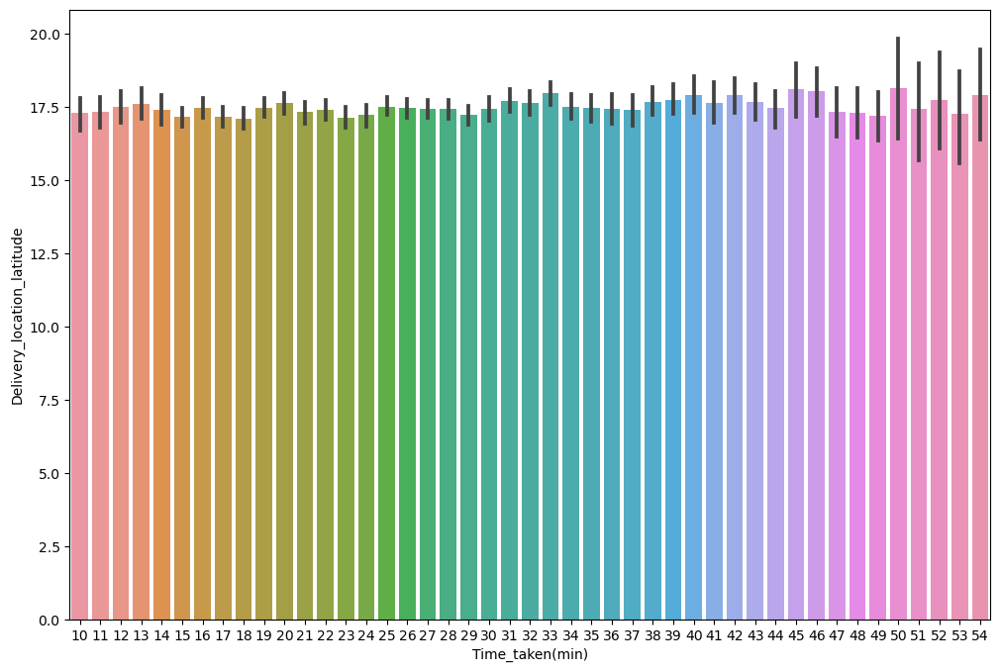

In [33]:
plt.figure(figsize=(12,8))
sns.barplot(data=df, x="Time_taken(min)" , y='Delivery_location_latitude')

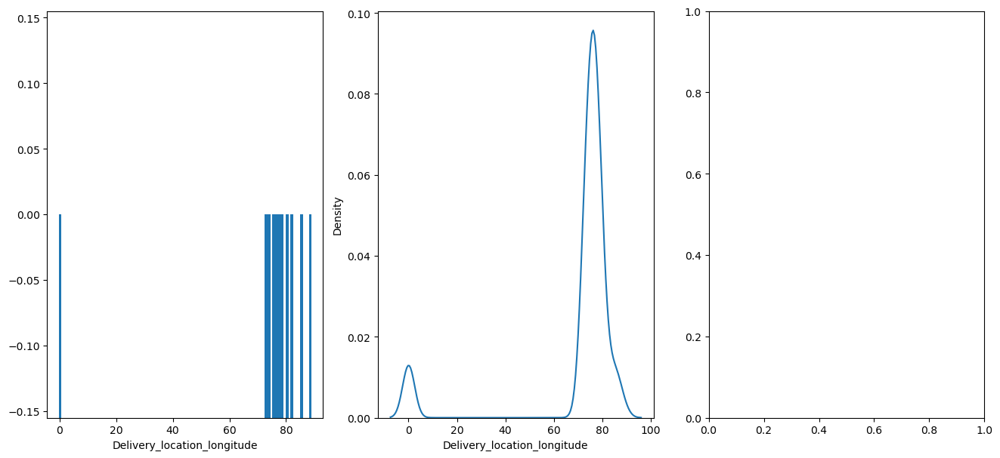

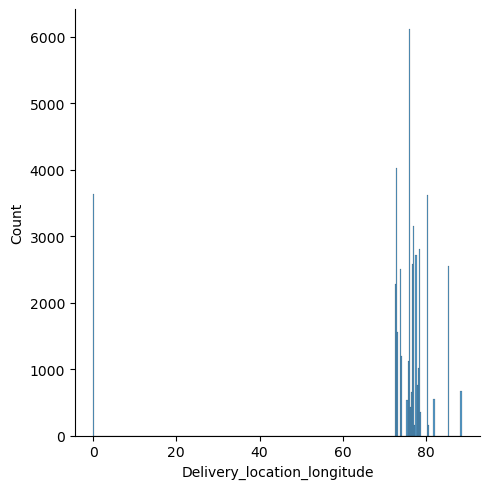

In [34]:
fig , axes = plt.subplots(1,3,figsize=(16,7))
sns.rugplot(ax = axes[0], data=df, x="Delivery_location_longitude", height=0.5)
sns.kdeplot(ax = axes[1], data=df, x="Delivery_location_longitude")
sns.displot(ax = axes[2], data=df, x="Delivery_location_longitude")

<Axes: xlabel='Time_taken(min)', ylabel='Delivery_location_longitude'>

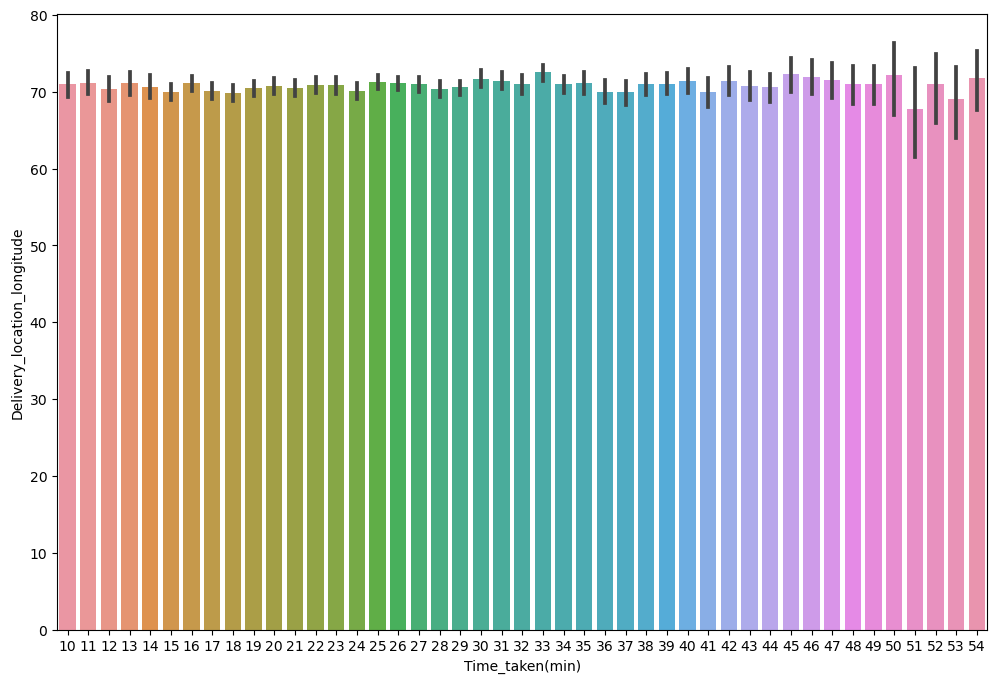

In [35]:
plt.figure(figsize=(12,8))
sns.barplot(data=df, x="Time_taken(min)" , y='Delivery_location_longitude')

In [36]:
##The effect of a person's Type_of_vehicle income on your minute
fig = px.histogram(df, 
             x="Time_taken(min)", 
             y="Type_of_vehicle", 
             color="Time_taken(min)",
             title="Time_taken(min) Based on Type_of_vehicle", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.show()

In [37]:
##The effect of a person's Type_of_orde income on your minute
fig = px.histogram(df, 
             x="Time_taken(min)", 
             y="Type_of_order", 
             color="Time_taken(min)",
             title="Time_taken(min) Based on Type_of_order", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.show()

# Dealing with outliers

***delivery person age***

In [39]:
from sklearn.preprocessing import LabelEncoder

labelencoder = LabelEncoder()

df['Delivery_person_Age'] = labelencoder.fit_transform(df['Delivery_person_Age'])

In [40]:
def find_outliers_IQR(df):
    q1 = df.quantile(0.25)
    q3 = df.quantile(0.75)
    
    iqr = q3 - q1
    
    outliers = df[((df<(q1-1.5*iqr))| (df>(q3 + 1.5*iqr)))]
    return outliers


outliers = find_outliers_IQR(df['Delivery_person_Age'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

number of outliers0
max outliers valuenan
min outliers valuenan


###***delivery person rating***

In [41]:
df['Delivery_person_Ratings'].describe()

count    45162.000000
mean         4.632691
std          0.322902
min          1.000000
25%          4.500000
50%          4.700000
75%          4.800000
max          6.000000
Name: Delivery_person_Ratings, dtype: float64

In [42]:
def find_outliers_IQR(df):
    q1 = df.quantile(0.25)
    q3 = df.quantile(0.75)
    
    iqr = q3 - q1
    
    outliers = df[((df<(q1-1.5*iqr))| (df>(q3 + 1.5*iqr)))]
    return outliers


outliers = find_outliers_IQR(df['Delivery_person_Ratings'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

number of outliers2453
max outliers value6.0
min outliers value1.0


In [43]:
df.drop(index=outliers.index,inplace=True)

In [44]:
outliers = find_outliers_IQR(df['Delivery_person_Ratings'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

number of outliers1427
max outliers value4.1
min outliers value4.1


In [45]:
df["Delivery_person_Ratings"].describe()

count    42709.000000
mean         4.682730
std          0.223328
min          4.100000
25%          4.600000
50%          4.700000
75%          4.900000
max          5.000000
Name: Delivery_person_Ratings, dtype: float64

In [46]:
fig=px.histogram(df, x='Delivery_person_Ratings')
fig.show()

In [47]:
fig=px.box(df, y='Delivery_person_Ratings')
fig.show()

***resturant latitude***

In [48]:
df['Restaurant_latitude'].describe()

count    42709.000000
mean        17.357020
std          7.341004
min          0.000000
25%         12.934179
50%         18.554382
75%         22.732225
max         30.914057
Name: Restaurant_latitude, dtype: float64

In [49]:
def find_outliers_IQR(df):
    q1 = df.quantile(0.25)
    q3 = df.quantile(0.75)
    
    iqr = q3 - q1
    
    outliers = df[((df<(q1-1.5*iqr))| (df>(q3 + 1.5*iqr)))]
    return outliers


outliers = find_outliers_IQR(df['Restaurant_latitude'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

number of outliers0
max outliers valuenan
min outliers valuenan


In [50]:
fig=px.histogram(df, x='Restaurant_latitude')
fig.show()

In [51]:
fig=px.box(df, y='Restaurant_latitude')
fig.show()

***resturant longtitude***

In [52]:
df['Restaurant_longitude'].describe()

count    42709.000000
mean        70.683576
std         21.246027
min          0.000000
25%         73.170283
50%         75.898497
75%         78.044095
max         88.433452
Name: Restaurant_longitude, dtype: float64

In [53]:
def find_outliers_IQR(df):
    q1 = df.quantile(0.25)
    q3 = df.quantile(0.75)
    
    iqr = q3 - q1
    
    outliers = df[((df<(q1-1.5*iqr))| (df>(q3 + 1.5*iqr)))]
    return outliers


outliers = find_outliers_IQR(df['Restaurant_longitude'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

number of outliers4236
max outliers value88.433452
min outliers value0.0


In [54]:
df.drop(index=outliers.index,inplace=True)

outliers = find_outliers_IQR(df['Restaurant_longitude'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

df["Restaurant_longitude"].describe()

number of outliers2261
max outliers value85.33982
min outliers value85.316842


count    38473.000000
mean        76.690530
std          3.159604
min         72.768726
25%         73.896485
50%         76.606650
75%         78.057044
max         85.339820
Name: Restaurant_longitude, dtype: float64

In [55]:
fig=px.histogram(df, x='Restaurant_longitude')
fig.show()

In [56]:
fig=px.box(df, y='Restaurant_longitude')
fig.show()

***delivery location latitude***

In [57]:
df.describe()['Delivery_location_latitude']  

count    38473.000000
mean        18.871721
std          5.484179
min          9.967144
25%         13.059780
50%         19.044237
75%         22.817021
max         31.054057
Name: Delivery_location_latitude, dtype: float64

In [58]:
def find_outliers_IQR(df):
    q1 = df.quantile(0.25)
    q3 = df.quantile(0.75)
    
    iqr = q3 - q1
    
    outliers = df[((df<(q1-1.5*iqr))| (df>(q3 + 1.5*iqr)))]
    return outliers


outliers = find_outliers_IQR(df['Delivery_location_latitude'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

number of outliers0
max outliers valuenan
min outliers valuenan


In [59]:
fig=px.histogram(df, x='Delivery_location_latitude')
fig.show()

In [60]:
fig=px.box(df, y='Delivery_location_latitude')
fig.show()

***delivery location longitude***

In [61]:
df['Delivery_location_longitude'].describe()  

count    38473.000000
mean        76.753319
std          3.159859
min         72.778726
25%         73.926619
50%         76.642278
75%         78.137553
max         85.469820
Name: Delivery_location_longitude, dtype: float64

In [62]:
def find_outliers_IQR(df):
    q1 = df.quantile(0.25)
    q3 = df.quantile(0.75)
    
    iqr = q3 - q1
    
    outliers = df[((df<(q1-1.5*iqr))| (df>(q3 + 1.5*iqr)))]
    return outliers


outliers = find_outliers_IQR(df['Delivery_location_longitude'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

number of outliers2261
max outliers value85.46982
min outliers value85.326842


In [63]:
df.drop(index=outliers.index,inplace=True)

outliers = find_outliers_IQR(df['Delivery_location_longitude'])
print ('number of outliers'+str(len(outliers)))
print ('max outliers value'+str(outliers.max()))
print ('min outliers value'+str(outliers.min()))

df["Delivery_location_longitude"].describe()

number of outliers0
max outliers valuenan
min outliers valuenan


count    36212.000000
mean        76.214158
std          2.379386
min         72.778726
25%         73.893460
50%         76.015287
75%         77.715748
max         82.000187
Name: Delivery_location_longitude, dtype: float64

In [64]:
fig=px.histogram(df, x='Delivery_location_longitude')
fig.show()

In [65]:
fig=px.box(df, y='Delivery_location_longitude')
fig.show()

# Data Preprocessing

**LabelEncoding**

In [66]:
#df_cat.drop('Delivery_person_ID',axis=1,inplace=True)
encoder=LabelEncoder()
for feature in df_cat.columns:
    df_cat[feature]=encoder.fit_transform(df_cat[feature])

In [67]:
#concatenating back the numerical and categorical features
df_new_=pd.concat((df_num,df_cat),axis=1)

In [68]:
df_new_.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45162 entries, 0 to 45592
Data columns (total 10 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Delivery_person_Age          45162 non-null  float64
 1   Delivery_person_Ratings      45162 non-null  float64
 2   Restaurant_latitude          45162 non-null  float64
 3   Restaurant_longitude         45162 non-null  float64
 4   Delivery_location_latitude   45162 non-null  float64
 5   Delivery_location_longitude  45162 non-null  float64
 6   ID                           45162 non-null  int32  
 7   Delivery_person_ID           45162 non-null  int32  
 8   Type_of_order                45162 non-null  int32  
 9   Type_of_vehicle              45162 non-null  int32  
dtypes: float64(6), int32(4)
memory usage: 4.1 MB


## 📈 Training a Linear Regression Model 

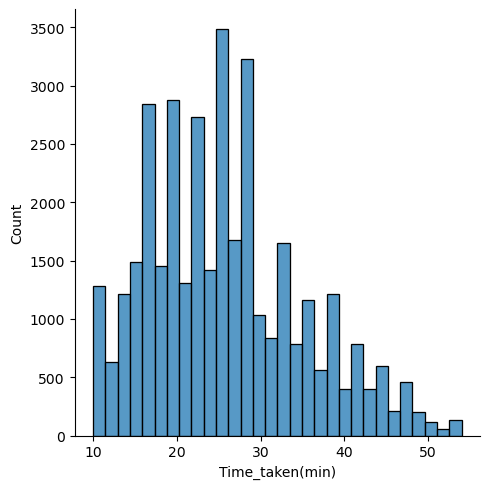

In [69]:
sns.displot(df['Time_taken(min)'] , bins=30)

### Determine the features and target variable

In [70]:
X=df_new_.copy()
y=time_taken

### Split the DataSet to train and test

In [71]:
from sklearn.model_selection import train_test_split

In [72]:
#train test split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.10,random_state=42)

### Train the Model using the X_train and y_train

In [73]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression()
lr.fit(X_train,y_train)

LinearRegression()

## Coeficient Matrix (Find the coefficients)

In [74]:
#Regression coefficients
print("Intercept", lr.intercept_ )

for i in zip(X_train.columns, lr.coef_):
    print(i)
    
print("R-squared", lr.score(X_train,y_train)) 

Intercept 47.49099493839342
('Delivery_person_Age', 13.569521154177137)
('Delivery_person_Ratings', -40.60311169683748)
('Restaurant_latitude', -1563.0437399420523)
('Restaurant_longitude', 1475.7233760009133)
('Delivery_location_latitude', 1568.5742783611652)
('Delivery_location_longitude', -1479.1872208222887)
('ID', 2.537554184631113e-06)
('Delivery_person_ID', -0.0001337086200095527)
('Type_of_order', 0.03605954681450774)
('Type_of_vehicle', -1.1916613738923465)
R-squared 0.26232047225155875


In [75]:
pd.DataFrame(lr.coef_, X.columns, columns=['Coeficient'])

,Coeficient
Delivery_person_Age,13.569521
Delivery_person_Ratings,-40.603112
Restaurant_latitude,-1563.043740
Restaurant_longitude,1475.723376
Delivery_location_latitude,1568.574278
Delivery_location_longitude,-1479.187221
ID,0.000003
Delivery_person_ID,-0.000134
Type_of_order,0.036060
Type_of_vehicle,-1.191661


### Predicting test data 

In [76]:
y_pred=lr.predict(X_test)
print('Mean absolute error:{}'.format(mean_absolute_error(y_test,y_pred)))
print('r2_score:{}'.format(r2_score(y_test,y_pred)))

Mean absolute error:6.496527730805045
r2_score:0.2455876612528738


In [77]:
pd.DataFrame({'Y_Test': y_test,'Y_Pred':y_pred }).head(5)

,Y_Test,Y_Pred
30128,46,31.130916
32362,19,24.483147
26098,40,26.870081
35492,36,23.298173
36839,33,26.912073


<Axes: ylabel='Time_taken(min)'>

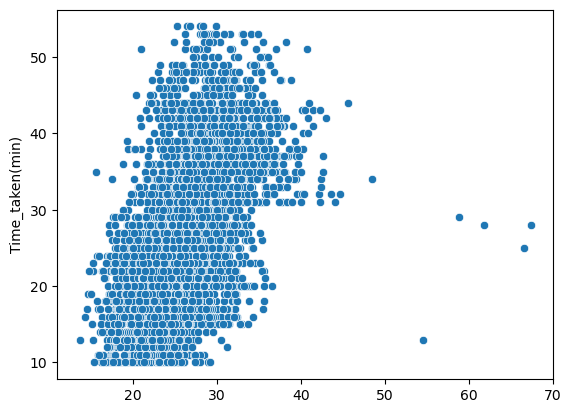

In [78]:
sns.scatterplot(x=y_pred,y=y_test)

## Residuals (Difference between y_test and y_pred)

Text(0, 0.5, 'Y-Pred')

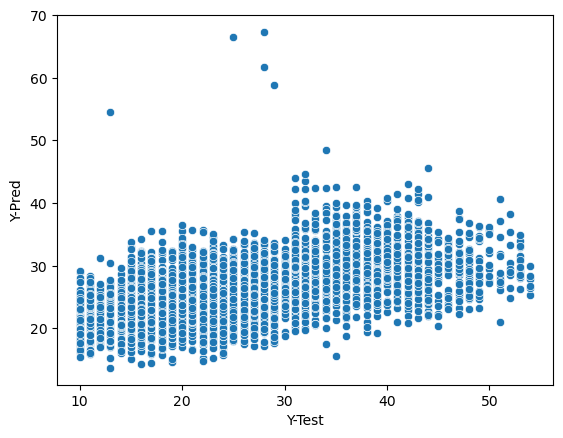

In [79]:
test_residuals=y_test-y_pred

sns.scatterplot(x=y_test, y=y_pred)
plt.xlabel('Y-Test')
plt.ylabel('Y-Pred')

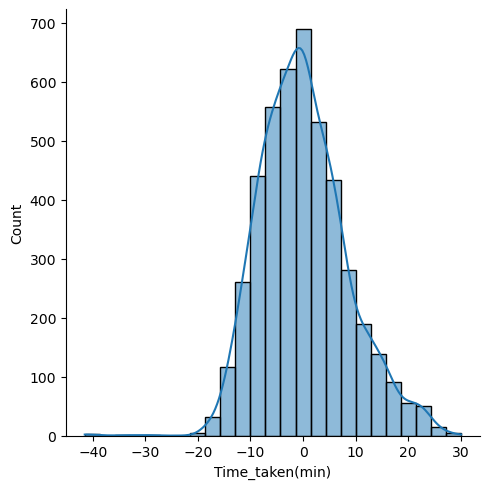

In [80]:
sns.displot(test_residuals, bins=25, kde=True)

Text(0, 0.5, 'residuals')

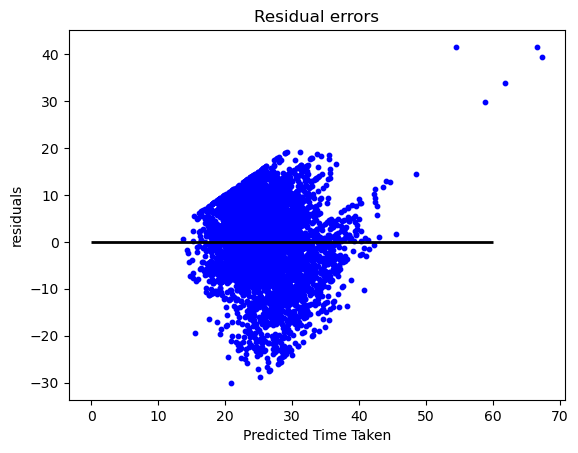

In [81]:
#Residual Plot
plt.scatter(lr.predict(X_test), lr.predict(X_test) - y_test,
            color = "b", s = 10, label = "Test Data")
plt.hlines(y = 0, xmin = 0, xmax = 60, linewidth = 2, color = 'k')
plt.title("Residual errors")
plt.xlabel("Predicted Time Taken")
plt.ylabel("residuals")

In [82]:
#print("Food Delivery Time Prediction")
#a = int(input("Age of Delivery Partner: "))
#b = float(input("Ratings of Previous Deliveries: "))
#c = int(input("Total Distance: "))

#features = np.array([[a, b, c]])
#print("Predicted Delivery Time in Minutes = ", lr.predict(features))


**Best wish to you ;)**

**ArmaN**